In [1]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.pyplot as plt
import numpy as np

1c

In [12]:
pi = np.pi
x = np.linspace(.01*pi, 2 * np.pi, 100,endpoint=False)
print(x[0]/pi,x[-1]/pi,(x[1]-x[0])/pi)

0.01 1.9801 0.0199


h=0.06346651825433926, k=0.001, mu=0.2482622302196381


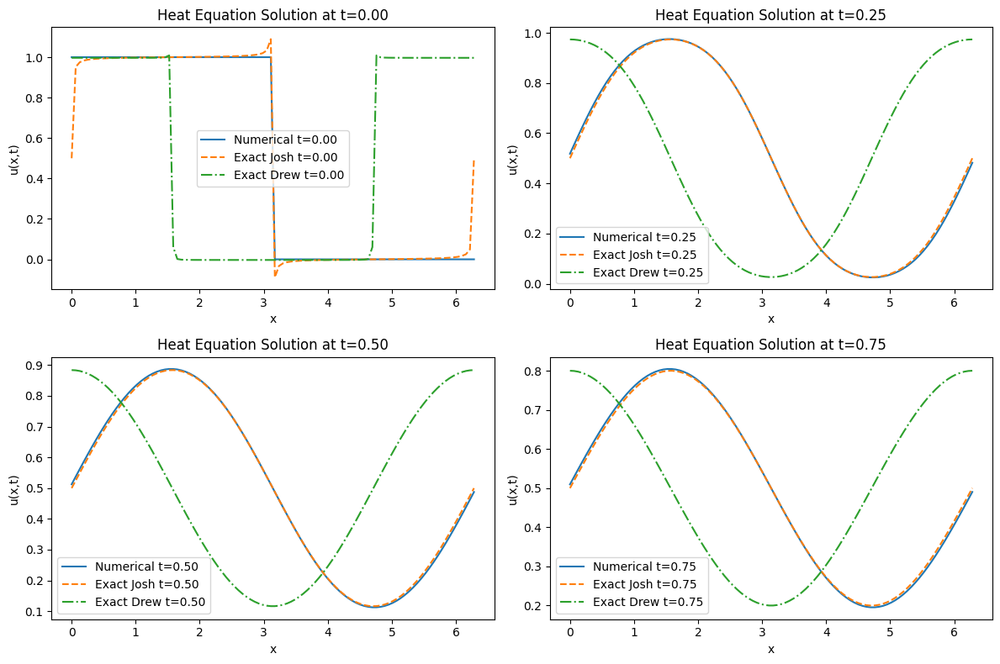

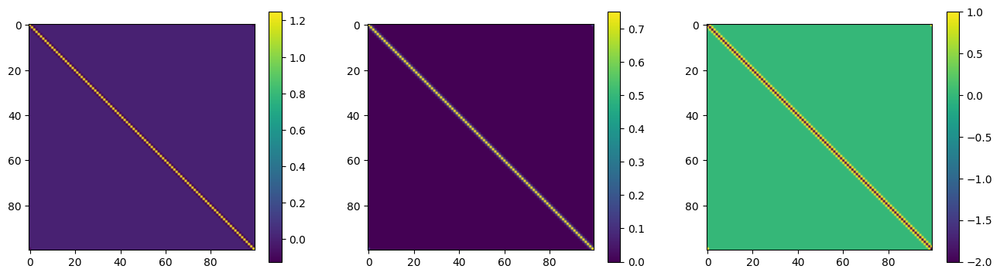

In [5]:
"""
Name: CN : Crank-Nicolson
Purpose: compute the time evolution of the 1D heat equation using the 
Crank-Nicolson method with periodic boundary conditions
Author: Joshua Belieu | Fletch
Date written: 2025-11-06
Last modified: 2025-11-06
Inputs:
- n: int, number of spatial points
- tr: float, time resolution
- alpha: float, diffusion coefficient
- mmax: int, number of Fourier modes in exact solution
Outputs:
- Plots of numerical and exact solutions at various times
Dependencies:
- numpy, matplotlib
"""

n = 100# number of spatial points
# x = np.linspace(0, 2 * np.pi, n,endpoint=False) # spatial grid
x = np.linspace(0.0, 2 * np.pi, n,endpoint=True) # spatial grid
tr=0.001 # time resolution
t = np.arange(0,1+tr,tr) # time grid
h = x[1]-x[0] # spatial step size
k = t[1]-t[0] # time step size
alpha = 1. # diffusion coefficient
mmax=100 # number of Fourier modes in exact solution
mu = alpha * k / ( h**2) 
print(f"h={h}, k={k}, mu={mu}")

# setting up the matrix A for the 1D Laplacian
A_main_diag = -2 * np.ones(n)
A_off_diag = np.ones(n-1)
A = (np.diag(A_main_diag) + np.diag(A_off_diag, 1) + np.diag(A_off_diag, -1))

# periodic BCs
A[0, -1] = 1 # coupling first and last points
# A[-1, 0] = 1 # coupling last and first points
# A[-1,:]=0
A[-1,0]=1
# A[-1,-1]=1
# A[-1,:]*=h/2
# A /= h**2
# setting up the matrices for Crank-Nicolson
mat_unp1 = np.eye(n) - mu/2*A
mat_un = np.eye(n) + mu/2*A

# mat_unp1_inv = np.linalg.inv(mat_unp1)

# initial condition
ux0 = np.zeros(n)
# setting initial condition
for i,xi in enumerate(x):
    if 0 <= xi <= np.pi :
        ux0[i] = 1
    else :
        ux0[i] = 0
# print(ux0[-1],ux0[0])
# ux0[0]=0
# for i,xi in enumerate(x):
#     if 0 <= xi <= np.pi/2 :
#         ux0[i] = 1
#     elif 3*np.pi/2 < xi <= 2*np.pi :
#         ux0[i] = 1
# solution bookkeeping
u_list = [ux0]

# time-stepping loop
for ti in t[1:] :

    # uxnp1 = mat_unp1_inv @ (mat_un @ u_list[-1])
    # solve the linear system and save the result
    uxnp1 = np.linalg.solve(mat_unp1, mat_un @ u_list[-1])
    u_list.append(uxnp1)

# fourier series exact solution
am = lambda m : (1-np.cos(m*np.pi))/(m)
bm_drew = lambda m : 2/(m*np.pi)*np.sin(m * np.pi / 2)
bm_josh = lambda m : 1/(m*np.pi)*(1-(-1)**m)
u_at_t_josh = lambda tv : 0.5 + sum( bm_josh(m) * np.exp(- alpha*m**2 * tv) * np.sin(m * x) 
                               for m in range(1,mmax) )
u_at_t_drew = lambda tv : 0.5 + sum( bm_drew(m) * np.exp(- alpha*m**2 * tv) * np.cos(m * x) 
                               for m in range(1,mmax) )  
# u_at_t = lambda tv : 0.5 + sum( (am(m)*np.sin(m*x)+bm(m) * np.cos(m * x))* np.exp(- alpha*m**2 * tv)
#                                for m in range(1,mmax) )
u_exact_list_josh = [u_at_t_josh(ti) for ti in t]
u_exact_list_drew = [u_at_t_drew(ti) for ti in t]
min_idx_num = np.argmin(u_list[-1])
min_idx_exa_josh = np.argmin(u_exact_list_josh[-1])
min_idx_exa_drew = np.argmin(u_exact_list_drew[-1])
# print('phase shift: ', np.abs(x[min_idx_num] - x[min_idx_exa]) / pi)
# plotting
fig,axs = plt.subplots(2,2,figsize=(12,8)) 
target_times = [0, 0.25, 0.5, 0.75]
for ax, target_time in zip(axs.flatten(), target_times):
    idx = np.argmin(np.abs(t - target_time))
    ax.plot(x, u_list[idx], label='Numerical t={:.2f}'.format(t[idx]))
    ax.plot(x, u_exact_list_josh[idx], '--', label='Exact Josh t={:.2f}'.format(t[idx]))
    ax.plot(x, u_exact_list_drew[idx], '-.', label='Exact Drew t={:.2f}'.format(t[idx]))
    ax.legend()
    ax.set_xlabel('x')
    ax.set_ylabel('u(x,t)')
    ax.set_title('Heat Equation Solution at t={:.2f}'.format(t[idx]))
plt.tight_layout()
fig,axs = plt.subplots(1,3,figsize=(16,14))
im1 = axs[0].imshow(mat_unp1)
im2 = axs[1].imshow(mat_un)
im3 = axs[2].imshow(A)
fig.colorbar(im1, ax=axs[0],shrink=0.3)
fig.colorbar(im2, ax=axs[1],shrink=0.3)
fig.colorbar(im3, ax=axs[2],shrink=0.3);
# mat_unp1
# A

h=0.06283185307179587, k=0.001, mu=0.25330295910584444
L2 error at t=1.000000: 1.304528e-02


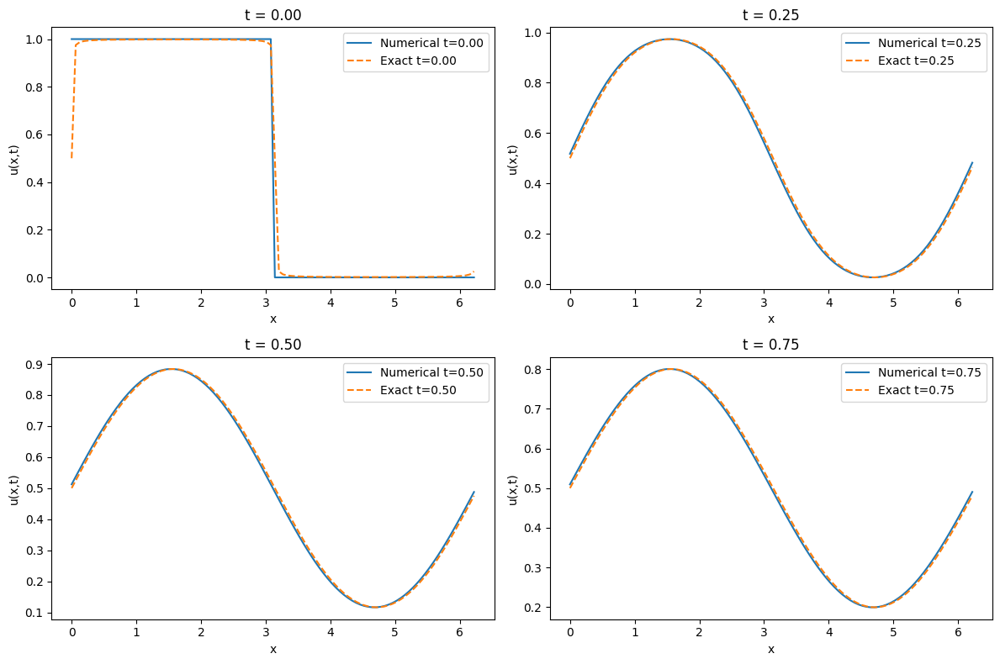

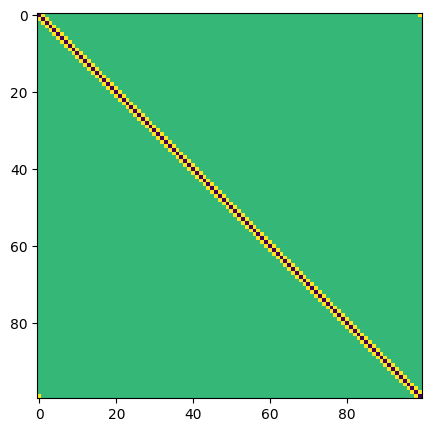

In [24]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters
n = 100                       # number of spatial points
x = np.linspace(0.0, 2*np.pi, n, endpoint=False)  # periodic grid
tr = 0.001
t = np.arange(0, 1+tr, tr)
h = x[1] - x[0]
k = t[1] - t[0]
alpha = 1.0
mmax = 200                    # Fourier modes for exact solution (increase for better accuracy)

# CFL-like parameter (useful bookkeeping)
mu = alpha * k / (h**2)
print(f"h={h}, k={k}, mu={mu}")

# Discrete Laplacian stencil (unscaled)
A_main = -2.0 * np.ones(n)
A_off  = 1.0  * np.ones(n-1)
A = np.diag(A_main) + np.diag(A_off, 1) + np.diag(A_off, -1)
# periodic wrap
A[0, -1] = 1.0
A[-1, 0] = 1.0

# Crank-Nicolson matrices
I = np.eye(n)
mat_unp1 = I - (mu / 2.0) * A   # (I - mu/2 * A)
mat_un   = I + (mu / 2.0) * A   # (I + mu/2 * A)

# Initial condition: 1 for x in [0,pi), else 0
u0 = np.zeros(n)
u0[(x >= 0) & (x < np.pi)] = 1.0

# Time stepping (CN)
u_list = [u0.copy()]
for _ in t[1:]:
    u_next = np.linalg.solve(mat_unp1, mat_un @ u_list[-1])
    u_list.append(u_next)

# Exact solution via Fourier series (vectorized)
m = np.arange(1, mmax)
b = (1 - (-1)**m) / (m * np.pi)     # b_m = 2/(m*pi) for odd m, 0 for even m
m_nonzero = m[b != 0]
b_nonzero = b[b != 0]
sin_mx = np.sin(np.outer(m_nonzero, x))  # shape (num_modes, n)

def exact_solution(tv):
    expo = np.exp(-alpha * (m_nonzero**2) * tv)[:, None]   # shape (num_modes,1)
    return 0.5 + np.sum((b_nonzero[:, None] * expo) * sin_mx, axis=0)

u_exact_list = [exact_solution(tv) for tv in t]

# Compute L2 error at final time
final_num = u_list[-1]
final_ex  = u_exact_list[-1]
L2_err = np.linalg.norm(final_num - final_ex) * np.sqrt(h)
print(f"L2 error at t={t[-1]:.6f}: {L2_err:.6e}")

# Plots: numerical vs exact at a few times
fig, axs = plt.subplots(2, 2, figsize=(12, 8))
target_times = [0.0, 0.25, 0.5, 0.75]
for ax, tt in zip(axs.flatten(), target_times):
    idx = np.argmin(np.abs(t - tt))
    ax.plot(x, u_list[idx], label=f'Numerical t={t[idx]:.2f}')
    ax.plot(x, u_exact_list[idx], '--', label=f'Exact t={t[idx]:.2f}')
    ax.legend()
    ax.set_xlabel('x')
    ax.set_ylabel('u(x,t)')
    ax.set_title(f't = {t[idx]:.2f}')
plt.tight_layout()
plt.show()

plt.figure(figsize=(16, 5))
plt.imshow(A)


2a

 
 Final Convergence : 8.45e-11 
 Iterations         : 54 / 100


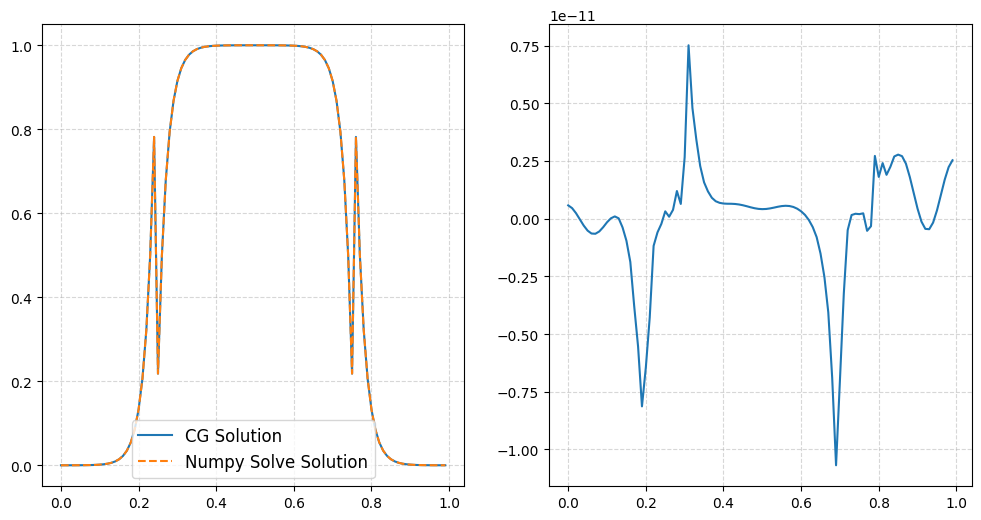

In [6]:
def conjugate_gradient_matrix ( f , A , u0 = None ,
                        tolerance = 1e-3 ,
                        max_iterations = 100 ,
                        show_final_stats = False ) :
    
    """
    Name: conjugate_gradient
    Purpose: solve a given system using conjugate gradient
    Author: Joshua Belieu | Fletch
    Date written: 2025-11-05
    Last modified: 2025-11-05
    Inputs:
    - f: ndarray. rhs of diff. eq.
    - A: ndarray. matrix of the system.
    - u0: ndarray. initial guess.
    - tolerance: float. convergence tolerance.
    - max_iterations: int. maximum number of iterations.
    Outputs:
    - ui: ndarray. solution of the system.
    Dependencies:
    - numpy.
    """

    if u0 is None : # if no init guess, make one.
        uim1 = np.zeros_like ( f )
    else : # make a copy of the initial guess
        uim1 = u0.copy()

    # init residuals and directions
    rim1 = f - A @ uim1
    pim1 = rim1.copy()

    # bookkeeping
    iteration = 0
    convergence = np.inf

    while convergence > tolerance and iteration < max_iterations :

        # w is A * p so that when we calc the next p, the result is orthogonal
        # to A. a is the step size in the p direction.
        wim1 = A @ pim1
        aim1 = (rim1.T @ rim1) / ( pim1.T @ wim1 )

        # update solution and residuals
        ui = uim1 + aim1 * pim1
        ri = rim1 - aim1 * wim1

        # convergence metric
        convergence = np.linalg.norm ( ri )

        # step size for p update.
        bim1 = (ri.T @ ri) / (rim1.T @ rim1)
        # update p
        pi = ri + bim1 * pim1

        # prepare for next iteration
        uim1 = ui.copy()
        rim1 = ri.copy()
        pim1 = pi.copy()

        iteration += 1

    if show_final_stats == True :

        s = f" \n Final Convergence : {convergence:.2e} \n Iterations \
        : {iteration} / {max_iterations}"
        print ( s )

    return ui

n = 100 # number of spatial points
x = np.linspace(0, 1, n,endpoint=False) # spatial grid
tr=0.001 # time resolution
t = np.arange(0,0.5+tr,tr) # time grid
h = x[1]-x[0] # spatial step size
k = t[1]-t[0] # time step size
alpha = 1. # diffusion coefficient
mmax=100 # number of Fourier modes in exact solution
mu = alpha * k / ( h**2) 
# setting up the matrix A for the 1D Laplacian
A_main_diag = -2 * np.ones(n)
A_off_diag = np.ones(n-1)
A = (np.diag(A_main_diag) + np.diag(A_off_diag, 1) + np.diag(A_off_diag, -1))

# neumann BCs
A[0, 0] = -1
A[0, 1] = 1
A[-1, -1] = -1
A[-1, -2] = 1
# A /= h**2

# setting up the matrices for Crank-Nicolson
mat_unp1 = np.eye(n) - mu/2*A
mat_un = np.eye(n) + mu/2*A

ux0 = np.zeros(n)
for i,xi in enumerate(x):
    if 0.25 <= xi <= 0.75 :
        ux0[i] = 1
# plt.imshow(A)
# plt.colorbar()
cg_sol = conjugate_gradient_matrix (  mat_un @ ux0 , mat_unp1,
                                    tolerance=1e-10,
                                    max_iterations=100,
                                    show_final_stats=True  )
u_alt = np.linalg.solve(mat_unp1, mat_un @ ux0)
fig,axs = plt.subplots(1,2,figsize=(12,6))
axs[0].plot(x, cg_sol, label='CG Solution')
axs[0].plot(x, u_alt, '--', label='Numpy Solve Solution')
axs[0].legend(fontsize=12)
axs[1].plot(x, cg_sol - u_alt, label='Difference (CG - Numpy)')
for ax in axs:
    ax.grid(ls='--',alpha=0.5)
    ax.tick_params(axis='both', which='major')
plt.show()

 
 Final Convergence : 5.32e-06 
 Iterations         : 1000 / 1000.0


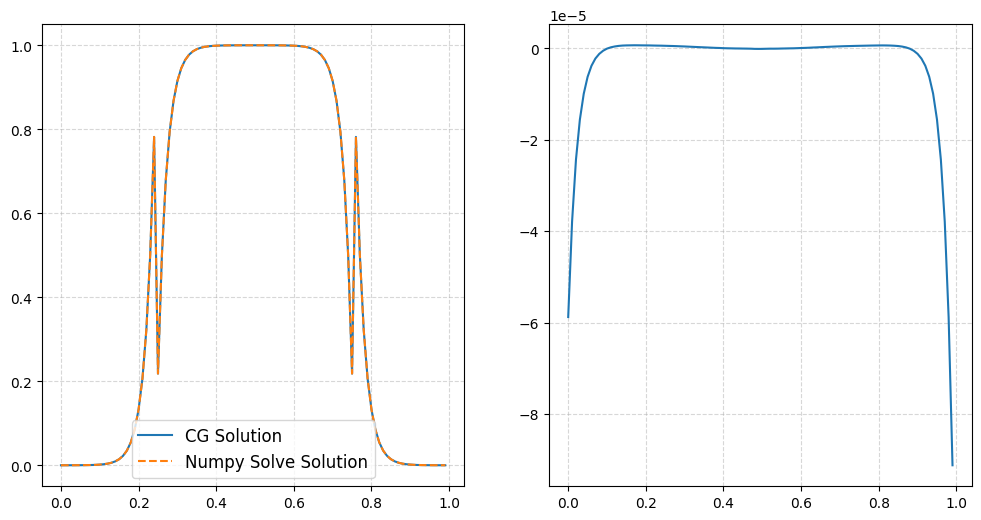

In [7]:
def A_action ( v ) :
    n = len(v)
    Av = np.zeros_like(v)
    for i in range(1,n-1):
        Av[i] = v[i] - mu/2 * (-2*v[i] + v[i-1] + v[i+1])
    # Neumann BCs
    Av[0] += v[1]
    Av[-1] += v[-2]
    return Av

def conjugate_gradient_matrix_free ( f , A_action , u0 = None ,
                        tolerance = 1e-3 ,
                        max_iterations = 100 ,
                        show_final_stats = False ) :
    
    """
    Name: conjugate_gradient
    Purpose: solve a given system using conjugate gradient method with no matrix storage
    Author: Joshua Belieu | Fletch
    Date written: 2025-11-05
    Last modified: 2025-11-05
    Inputs:
    - f: ndarray. rhs of diff. eq.
    - A: function. matrix-vector product function.
    - tolerance: float. convergence tolerance.
    - max_iterations: int. maximum number of iterations.
    Outputs:
    - ui: ndarray. solution of the system.
    Dependencies:
    - numpy.
    """

    if u0 is None : # if no init guess, make one.
        u = np.zeros_like ( f )
    else : # make a copy of the initial guess
        u = u0.copy()

    r = f - A_action ( u )
    p = r.copy()
    r_squared_old = np.dot ( r , r )

    # bookkeeping
    iteration = 0
    convergence = np.inf

    while convergence > tolerance and iteration < max_iterations :
        
        Ap = A_action ( p )
        alpha = r_squared_old / np.dot ( p , Ap )

        u += alpha * p
        r -= alpha * Ap
        r_squared_new = np.dot ( r , r )
        convergence = np.sqrt ( r_squared_new )

        beta = r_squared_new / r_squared_old
        p = r + beta * p
        r_squared_old = r_squared_new

        iteration += 1

    if show_final_stats == True :

        s = f" \n Final Convergence : {convergence:.2e} \n Iterations \
        : {iteration} / {max_iterations}"
        print ( s )

    return u

def rhs ( v ) :

    n = len(v)
    f = np.zeros_like(v)
    for i in range(1,n-1):
        f[i] = v[i] + mu/2 * ( v[i-1] - 2*v[i] + v[i+1] )
    # Neumann BCs
    f[0] = v[0] + mu/2 * ( v[1] - v[0] )
    f[-1] = v[-1] + mu/2 * ( v[-2] - v[-1] )
    
    return f

n = 100 # number of spatial points
x = np.linspace(0, 1, n,endpoint=False) # spatial grid
tr=0.001 # time resolution
t = np.arange(0,0.5+tr,tr) # time grid
h = x[1]-x[0] # spatial step size
k = t[1]-t[0] # time step size
alpha = 1. # diffusion coefficient
mu = alpha * k / ( h**2) 

ux0 = np.zeros(n)
for i,xi in enumerate(x):
    if 0.25 <= xi <= 0.75 :
        ux0[i] = 1
cg_sol = conjugate_gradient_matrix_free (  rhs(ux0) , A_action,
                                    tolerance=1e-10,
                                    max_iterations=1e3,
                                    show_final_stats=True  )
u_alt = np.linalg.solve(mat_unp1, mat_un @ ux0)
fig,axs = plt.subplots(1,2,figsize=(12,6))
axs[0].plot(x, cg_sol, label='CG Solution')
axs[0].plot(x, u_alt, '--', label='Numpy Solve Solution')
axs[0].legend(fontsize=12)
axs[1].plot(x, cg_sol - u_alt, label='Difference (CG - Numpy)')
for ax in axs:
    ax.grid(ls='--',alpha=0.5)
    ax.tick_params(axis='both', which='major')
plt.show()

2b

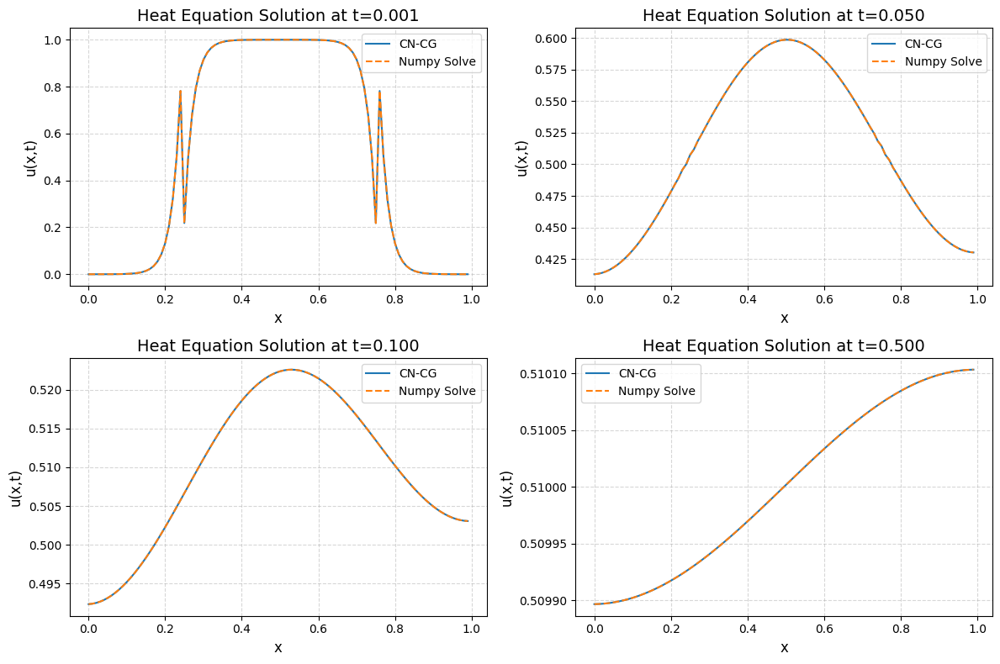

In [34]:
n = 100 # number of spatial points
x = np.linspace(0, 1, n,endpoint=False) # spatial grid
tr=0.001 # time resolution
t = np.arange(0,0.5+tr,tr) # time grid
h = x[1]-x[0] # spatial step size
k = t[1]-t[0] # time step size
alpha = 1. # diffusion coefficient
mmax=100 # number of Fourier modes in exact solution
mu = alpha * k / ( h**2) 
# setting up the matrix A for the 1D Laplacian
A_main_diag = -2 * np.ones(n)
A_off_diag = np.ones(n-1)
A = (np.diag(A_main_diag) + np.diag(A_off_diag, 1) + np.diag(A_off_diag, -1))

# neumann BCs
A[0, 0] = -1
A[0, 1] = 1
A[-1, -1] = -1
A[-1, -2] = 1
# A /= h**2

# setting up the matrices for Crank-Nicolson
mat_unp1 = np.eye(n) - mu/2*A
mat_un = np.eye(n) + mu/2*A

ux0 = np.zeros(n)
for i,xi in enumerate(x):
    if 0.25 <= xi <= 0.75 :
        ux0[i] = 1
u_cg_list = [  ux0 ]
u_alt_list = [ ux0 ]
res_list = []
for _ in t :
    cg_sol = conjugate_gradient_matrix (  mat_un @ u_cg_list[-1] , mat_unp1,
                                        tolerance=1e-10,
                                        max_iterations=150,
                                        show_final_stats=False  )
    u_alt = np.linalg.solve(mat_unp1, mat_un @ u_alt_list[-1])
    res = np.linalg.norm(cg_sol - u_alt)
    u_cg_list.append(cg_sol)
    u_alt_list.append(u_alt)
    res_list.append(res)
fig,axs = plt.subplots(2,2,figsize=(12,8)) 
target_times = [0.001, 0.05 , 0.1 , 0.5]
for ax, target_time in zip(axs.flatten(), target_times):
    idx = np.argmin(np.abs(t - target_time))
    ax.plot(x, u_cg_list[idx], label='CN-CG')
    ax.plot(x, u_alt_list[idx], '--', label='Numpy Solve')
    ax.legend()
    ax.set_xlabel('x',fontsize=12)
    ax.set_ylabel('u(x,t)',fontsize=12)
    ax.set_title('Heat Equation Solution at t={:.3f}'.format(t[idx]),fontsize=14)
    ax.grid(ls='--',alpha=0.5)
    ax.tick_params(axis='both', which='major')
plt.tight_layout()

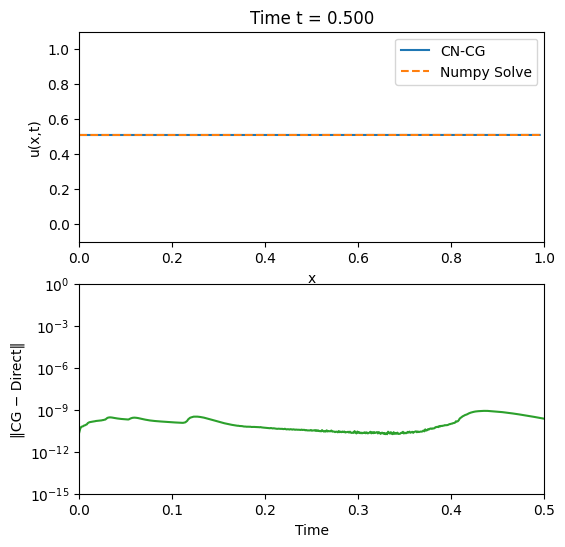

In [35]:
u_cg = np.array(u_cg_list)
u_alt = np.array(u_alt_list)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(6, 6))
line_cg, = ax1.plot(x, u_cg[0], label='CN-CG', color='C0')
line_alt, = ax1.plot(x, u_alt[0], '--', label='Numpy Solve', color='C1')
ax1.set_xlim(0, 1)
ax1.set_ylim(-0.1, 1.1)
ax1.set_xlabel('x')
ax1.set_ylabel('u(x,t)')
ax1.legend()

line_res, = ax2.plot([], [], color='C2')
ax2.set_xlim(0, t[-1])
ax2.set_ylim(1e-15, 1)
ax2.set_yscale('log')
ax2.set_xlabel('Time')
ax2.set_ylabel('‖CG − Direct‖')

def update(frame):
    line_cg.set_ydata(u_cg[frame])
    line_alt.set_ydata(u_alt[frame])
    line_res.set_data(t[:frame], res_list[:frame])
    ax1.set_title(f"Time t = {t[frame]:.3f}")
    return line_cg, line_alt, line_res

anim = FuncAnimation(fig, update, frames=len(t), interval=100, blit=True)
HTML(anim.to_jshtml())

Problem 3

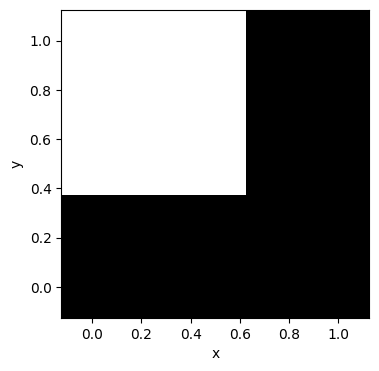

In [61]:
nx = ny = 5
x0 = y0 = 0.
xn = yn = 1.

x = np.linspace(x0, xn, nx, endpoint=True)
y = np.linspace(y0, yn, ny, endpoint=True)

hx = x[1] - x[0]
hy = y[1] - y[0]

X,Y = np.meshgrid(x, y)

mask = ~( ( X <= 0.5 ) & ( Y >= 0.5 ) )

plt.figure(figsize=(4,4))
plt.pcolormesh(X, Y, mask, shading='auto', cmap='Greys')
plt.xlabel('x')
plt.ylabel('y')
plt.gca().set_aspect('equal')
plt.show()

3a

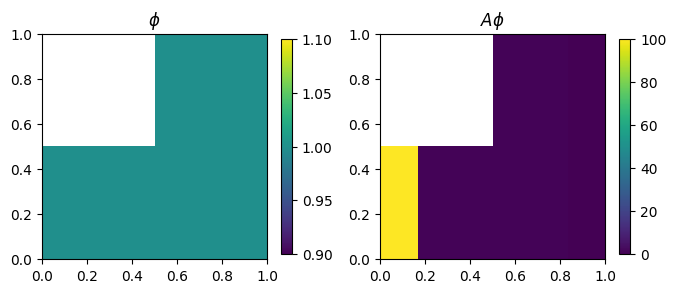

In [11]:
def Afun ( phi , mask , params = None ) :

    nx, ny = phi.shape

    if params is None :
        theta=0.5;kappa=1.;k=.001;hx=0.01;hy=0.01
    else :
        theta,kappa,k,hx,hy = params

    Aphi = phi.copy()
    Aphi[:,0] = 100*np.ones(nx) # dirichlet BC at left boundary 
    Aphi[:,-1] = np.zeros(nx) # dirichlet BC at right boundary
    Aphi[0,:]=Aphi[1,:] 
    Aphi[-1,:]=Aphi[-2,:]
    for i in range(1,nx-1):
        for j in range (1,ny-1):
            if not mask[i,j] :
                continue
            center = phi [ i , j ]
            left = phi [ i-1 , j ] if i > 0 else center
            right = phi [ i+1 , j ] if i < nx-1 else center
            down = phi [ i , j-1 ] if j > 0 else center
            up = phi [ i , j+1 ] if j < ny-1 else center

            laplacian = ( left - 2 * center+ right ) / ( hx**2 ) +\
                        ( up - 2 * center + down ) / ( hy**2 )
            
            Aphi[i,j] = center - theta * kappa * k * laplacian


    Aphi[~mask] = np.nan

    return Aphi

'''
unit test
'''

test_flag = 1
if test_flag == 1 :

    nx = ny = 6
    x0 = y0 = 0.
    xn = yn = 1.
    x = np.linspace(x0, xn, nx, endpoint=True)
    y = np.linspace(y0, yn, ny, endpoint=True)
    hx = x[1] - x[0]
    hy = y[1] - y[0]
    X,Y = np.meshgrid(x, y)
    mask = ~( ( X <= 0.5 ) & ( Y >= 0.5 ) )

    phi = np.ones((nx,ny))
    Aphi = Afun ( phi , mask = mask )
    phi[~mask] = np.nan

    fig,axs = plt.subplots(1,2,figsize=(8,4))
    im1 = axs[0].imshow(phi,origin='lower',extent=(x0,xn,y0,yn))
    axs[0].set_title(r'$\phi$')
    fig.colorbar(im1, ax=axs[0],shrink=0.7)
    im2 = axs[1].imshow(Aphi,origin='lower',extent=(x0,xn,y0,yn))
    axs[1].set_title(r'$A\phi$')
    fig.colorbar(im2, ax=axs[1],shrink=0.7)
    plt.show()

3b

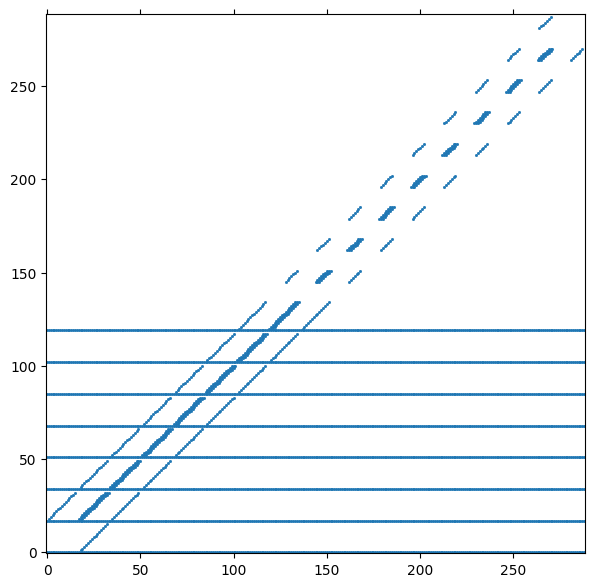

In [13]:
nx = ny = 17
N = nx * ny
x = np.linspace(x0, xn, nx, endpoint=True)
y = np.linspace(y0, yn, ny, endpoint=True)
hx = x[1] - x[0]
hy = y[1] - y[0]
X,Y = np.meshgrid(x, y)
mask = ~( ( X <= 0.5 ) & ( Y >= 0.5 ) )

ident = np.eye(nx)
params = (0.5,1.,0.001,1/17,1/17)
A = np.zeros((N, N))
for i in range(N):
    phi = np.zeros((nx, ny))
    phi.flat[i] = 1.0
    Aphi = Afun ( phi, mask=mask,params = params )
    A[:, i] = Aphi.flatten()

plt.figure(figsize=(7,7))
plt.spy(A, markersize=1,origin='lower');

(25, 25)
nx=5, Δt=1e-03, cond(A)=inf


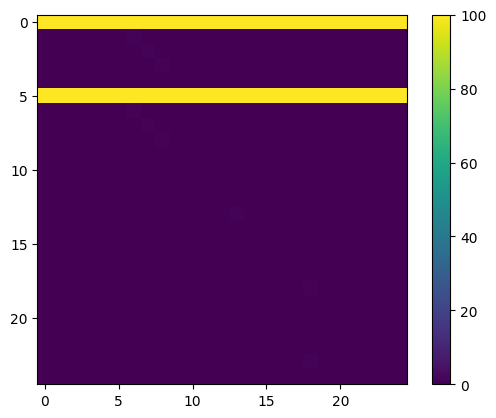

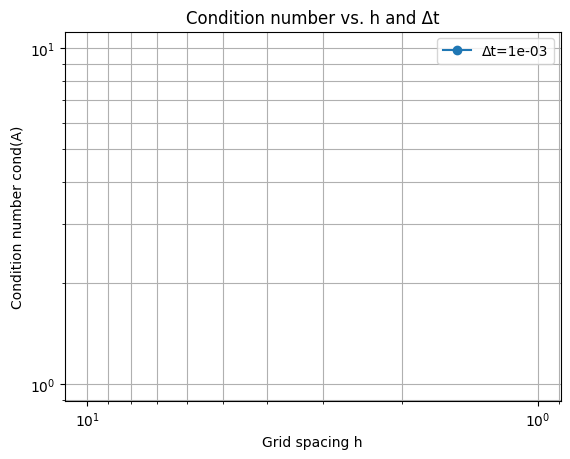

In [24]:
def build_A_and_cond(nx, dt):
    x = np.linspace(0, 1, nx, endpoint=True)
    y = np.linspace(0, 1, nx, endpoint=True)
    hx = hy = x[1] - x[0]
    X, Y = np.meshgrid(x, y)
    mask = ~( (X <= 0.5) & (Y >= 0.5) )

    N = nx * nx
    params = (0.5, 1.0, dt, hx, hy)

    A = np.zeros((N, N))
    for i in range(N):
        phi = np.zeros((nx, nx))
        phi.flat[i] = 1.0
        Aphi = Afun(phi, mask=mask, params=params)
        A[:, i] = np.nan_to_num(Aphi).flatten()

    print(A.shape)
    plt.imshow(A)
    plt.colorbar()
    condA = np.linalg.cond(A)
    return condA

# hs = [1/8, 1/16, 1/32]
hs=[1/4]
nx_values = [int(1/h)+1 for h in hs]
dts = [1e-3, 1e-4, 1e-5]
dts=[1e-3]

cond_results = {}

for dt in dts:
    cond_results[dt] = []
    for nx in nx_values:
        condA = build_A_and_cond(nx, dt)
        cond_results[dt].append(condA)
        print(f"nx={nx}, Δt={dt:.0e}, cond(A)={condA:.3e}")

# === Plot ===
plt.figure()
for dt, conds in cond_results.items():
    plt.loglog(hs, conds, 'o-', label=f'Δt={dt:.0e}')
plt.gca().invert_xaxis()
plt.xlabel('Grid spacing h')
plt.ylabel('Condition number cond(A)')
plt.legend()
plt.grid(True, which='both')
plt.title('Condition number vs. h and Δt')
plt.show()